In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

from cellpose import models, io, plot

from skimage.color import rgb2hed
from skimage.filters import threshold_otsu
from skimage.morphology import binary_dilation, disk
from skimage.measure import regionprops_table

# work directory
os.chdir("/Volumes/FlynnDisk/PengIHC/1205/")

# Better Visulization
plt.rcParams["figure.dpi"] = 300

# read image
img_rgb = io.imread("B-642-3.tif")       # shape: (H, W, 3)

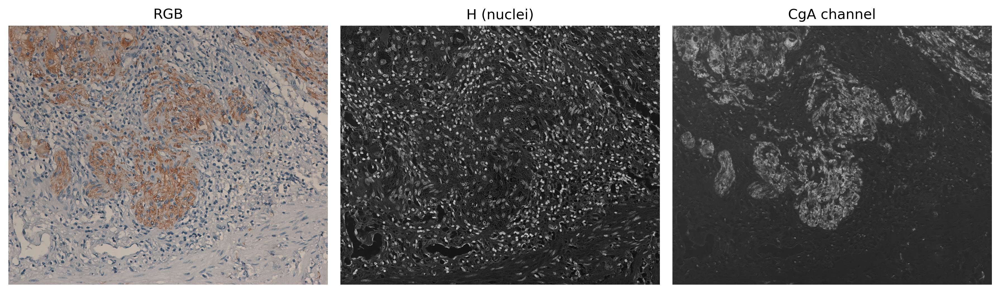

In [2]:
# color deconvolution: RGB -> H, E, DAB
# 对这张三重染色，H 通道主要是苏木素核，
# E 通道被 CA19-9 占据，可以视作肿瘤细胞通道，
# DAB 通道是我们感兴趣的分子标志
# 如果后面要做归一化 / hed 分解，就在 img_rgb 的基础上处理
img_f = img_rgb.astype(np.float32) / 255.0
ihc_hed = rgb2hed(img_f)
H = ihc_hed[:, :, 0]
E = ihc_hed[:, :, 1]
D = ihc_hed[:, :, 2]
# 为了直观，把它们归一化到 [0,1]
def normalize_channel(ch):
    ch = ch.astype(np.float32)
    ch = ch - ch.min()
    if ch.max() > 0:
        ch = ch / ch.max()
    return ch

H_norm = normalize_channel(H)

plt.figure(figsize=(16, 5))
plt.subplot(141); plt.imshow(img_rgb); plt.title("RGB"); plt.axis("off")
plt.subplot(142); plt.imshow(H_norm, cmap="gray"); plt.title("H (nuclei)"); plt.axis("off")
plt.subplot(143); plt.imshow(D, cmap="gray"); plt.title("CgA channel"); plt.axis("off")
plt.tight_layout()
plt.show()

In [3]:
# load model
nuc_model=models.CellposeModel(gpu=True)

Total nuclei detected: 1370


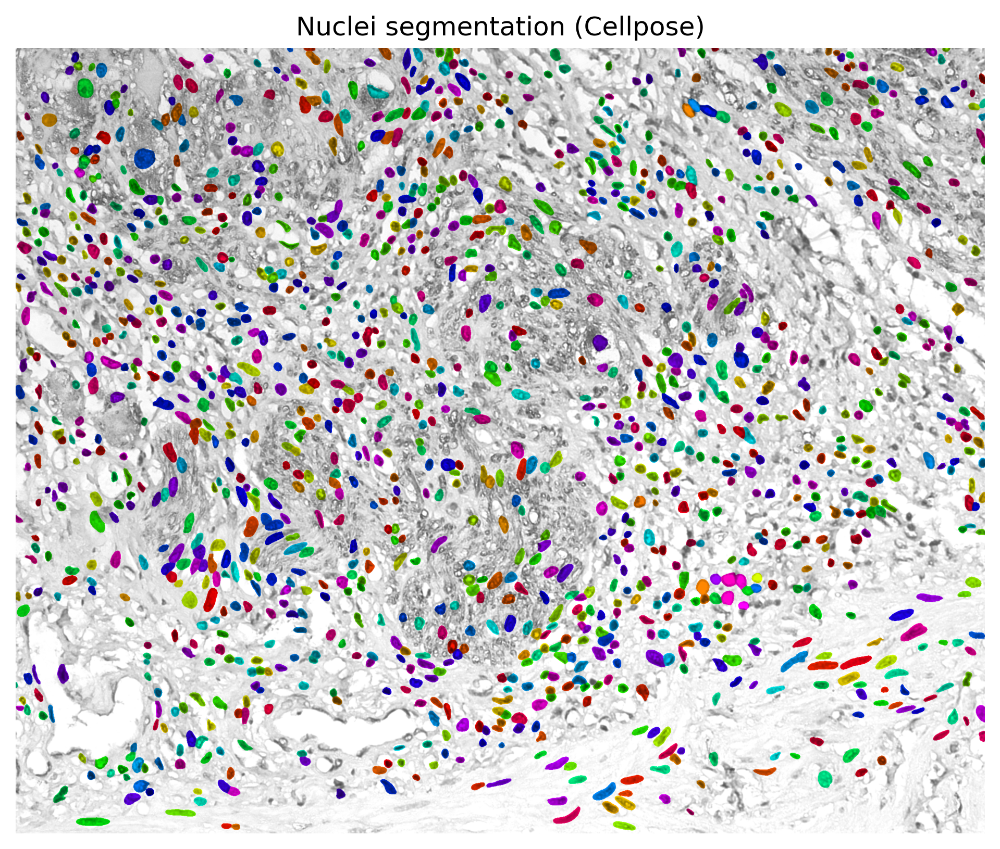

In [4]:
flow_threshold_nuc = 0.38       # 从 0.4 放宽
cellprob_threshold_nuc = -1.4  # 从 -3 再往下放
diameter_nuc = 18              # 原来 18 的话可以试试 14

masks_nuc, flows_nuc, styles_nuc = nuc_model.eval(
    H_norm,
    batch_size=16,
    diameter=diameter_nuc,
    flow_threshold=flow_threshold_nuc,
    cellprob_threshold=cellprob_threshold_nuc,
)

nuc_labels = np.unique(masks_nuc)
nuc_labels = nuc_labels[nuc_labels != 0]
print(f"Total nuclei detected: {len(nuc_labels)}")

overlay_nuc = plot.mask_overlay(img_rgb, masks_nuc)
plt.figure(figsize=(8, 8))
plt.imshow(overlay_nuc)
plt.axis("off")
plt.title("Nuclei segmentation (Cellpose)")
plt.show()

[D-range] B-642-3.tif
  min=0.000000, max=0.196035, mean=0.045234
Temporary CgA Otsu threshold (raw D): 0.0601


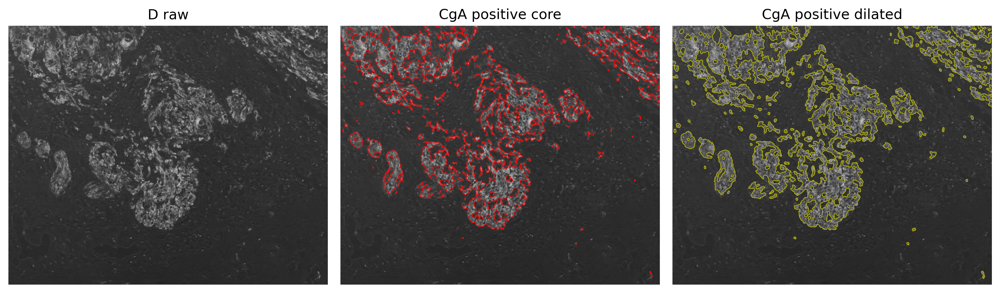

In [5]:
from scipy import ndimage as ndi
from skimage.filters import threshold_otsu
import pandas as pd
from skimage.morphology import binary_closing, binary_erosion, remove_small_objects


def inspect_D_range(path: str) -> None:
    img_rgb = io.imread(path)
    img_f = img_rgb.astype(np.float32) / 255.0

    ihc_hed = rgb2hed(img_f)
    D_raw = ihc_hed[:, :, 2]

    print(f"[D-range] {os.path.basename(path)}")
    print(f"  min={D_raw.min():.6f}, max={D_raw.max():.6f}, mean={D_raw.mean():.6f}")

slides_to_check = [
    "B-642-3.tif",   # 明显阳性
]

for fname in slides_to_check:
    inspect_D_range(fname)
    
t_cga = threshold_otsu(D)
print(f"Temporary CgA Otsu threshold (raw D): {t_cga:.4f}")

pos_area = D > t_cga

pos_area = remove_small_objects(pos_area, min_size=150)
pos_area = binary_closing(pos_area, footprint=disk(10))

# 保守 core（比原始区域略收缩一点）
pos_core = binary_erosion(pos_area, footprint=disk(3))

# 扩张区域：在 core 基础上向外扩几像素
pos_dil = binary_dilation(pos_core, footprint=disk(5))

plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1); plt.imshow(D, cmap="gray"); plt.title("D raw"); plt.axis("off")
plt.subplot(1, 3, 2); plt.imshow(D, cmap="gray"); plt.contour(pos_core, colors="r", linewidths=0.5)
plt.title("CgA positive core"); plt.axis("off")
plt.subplot(1, 3, 3); plt.imshow(D, cmap="gray"); plt.contour(pos_dil, colors="y", linewidths=0.5)
plt.title("CgA positive dilated"); plt.axis("off")
plt.tight_layout()
plt.show()

Total cells: 1370
Strong positive cells: 113  (fraction=0.082)
Broad positive cells:  146  (fraction=0.107)


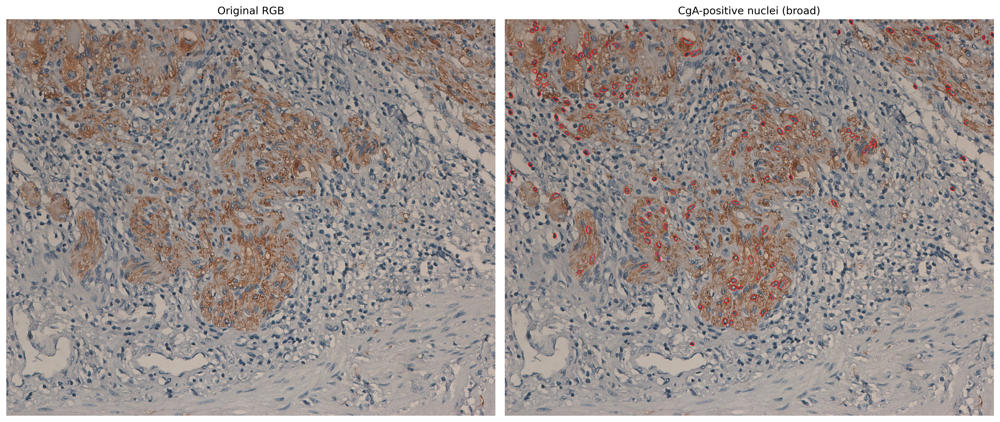

In [6]:
# nuclei centroids
props = regionprops_table(
    masks_nuc,
    properties=("label", "centroid")
)
nuc_df = pd.DataFrame(props)

strong_flags = []
broad_flags = []

h, w = pos_core.shape

for cy, cx in zip(nuc_df["centroid-0"], nuc_df["centroid-1"]):
    r = int(round(cy))
    c = int(round(cx))
    in_strong = False
    in_broad = False

    if 0 <= r < h and 0 <= c < w:
        in_strong = bool(pos_core[r, c])
        in_broad = bool(pos_dil[r, c])

    strong_flags.append(in_strong)
    broad_flags.append(in_broad)

nuc_df["CgA_strong"] = strong_flags
nuc_df["CgA_broad"] = broad_flags

N_total = len(nuc_df)
N_strong = nuc_df["CgA_strong"].sum()
N_broad = nuc_df["CgA_broad"].sum()

print(f"Total cells: {N_total}")
print(f"Strong positive cells: {N_strong}  (fraction={N_strong / N_total:.3f})")
print(f"Broad positive cells:  {N_broad}  (fraction={N_broad / N_total:.3f})")

labels_strong = nuc_df.loc[nuc_df["CgA_strong"], "label"].to_numpy()
labels_broad = nuc_df.loc[nuc_df["CgA_broad"], "label"].to_numpy()

mask_strong = np.isin(masks_nuc, labels_strong)
mask_broad = np.isin(masks_nuc, labels_broad)

from skimage.segmentation import find_boundaries
from skimage.morphology import binary_dilation

bound_broad = find_boundaries(mask_broad, mode="inner")
bound_broad = binary_dilation(bound_broad, footprint=disk(1))

img_rgb = io.imread("B-642-3.tif")
base = img_rgb.astype(np.float32) / 255.0
overlay_outline = base.copy()

red = np.array([1.0, 0.0, 0.0], dtype=np.float32)
overlay_outline[bound_broad] = red

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
axes[0].imshow(img_rgb); axes[0].axis("off"); axes[0].set_title("Original RGB")
axes[1].imshow(overlay_outline); axes[1].axis("off"); axes[1].set_title("CgA-positive nuclei (broad)")
plt.tight_layout()
plt.show()



In [7]:
from skimage.measure import regionprops_table
import pandas as pd

props = regionprops_table(
    masks_nuc,
    properties=("label", "centroid")
)
nuc_df = pd.DataFrame(props)

h, w = pos_core.shape
strong_flags = []
broad_flags = []

for cy, cx in zip(nuc_df["centroid-0"], nuc_df["centroid-1"]):
    r = int(round(cy))
    c = int(round(cx))

    in_strong = False
    in_broad = False

    if 0 <= r < h and 0 <= c < w:
        in_strong = bool(pos_core[r, c])
        in_broad = bool(pos_dil[r, c])

    strong_flags.append(in_strong)
    broad_flags.append(in_broad)

nuc_df["CgA_strong"] = strong_flags
nuc_df["CgA_broad"] = broad_flags

N_total  = len(nuc_df)
N_strong = int(nuc_df["CgA_strong"].sum())
N_broad  = int(nuc_df["CgA_broad"].sum())

print(f"Total cells: {N_total}")
print(f"Strong positive cells: {N_strong}  (fraction={N_strong / N_total:.3f})")
print(f"Broad positive cells:  {N_broad}   (fraction={N_broad / N_total:.3f})")


Total cells: 1370
Strong positive cells: 113  (fraction=0.082)
Broad positive cells:  146   (fraction=0.107)


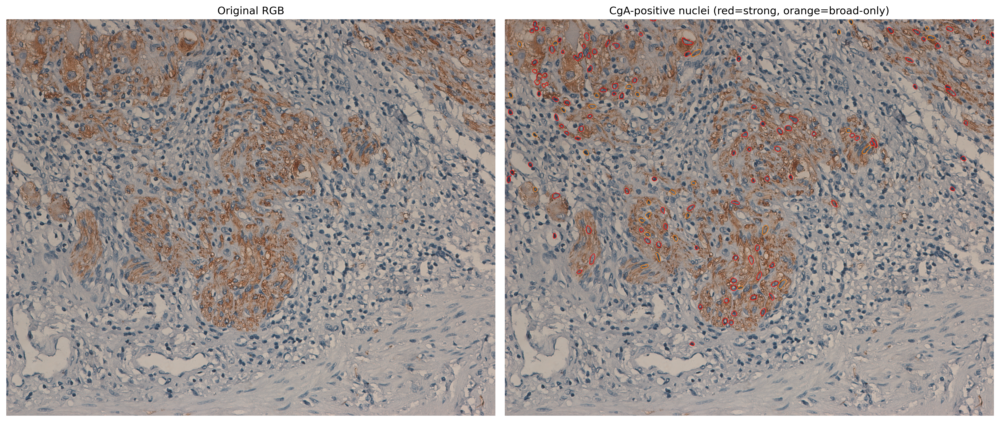

In [8]:
from skimage.segmentation import find_boundaries
from skimage.morphology import binary_dilation

labels_strong = nuc_df.loc[nuc_df["CgA_strong"], "label"].to_numpy()
labels_broad  = nuc_df.loc[nuc_df["CgA_broad"], "label"].to_numpy()

mask_strong = np.isin(masks_nuc, labels_strong)
mask_broad  = np.isin(masks_nuc, labels_broad)

# 轮廓
bound_strong = find_boundaries(mask_strong, mode="inner")
bound_strong = binary_dilation(bound_strong, footprint=disk(1))

bound_broad = find_boundaries(mask_broad, mode="inner")
bound_broad = binary_dilation(bound_broad, footprint=disk(1))

# broad-only = broad 中剔掉 strong 区域
bound_broad_only = np.logical_and(bound_broad, ~bound_strong)

img_rgb = io.imread("B-642-3.tif")
base = img_rgb.astype(np.float32) / 255.0
overlay = base.copy()

red    = np.array([1.0, 0.0, 0.0], dtype=np.float32)
orange = np.array([1.0, 0.5, 0.0], dtype=np.float32)

overlay[bound_strong]      = red
overlay[bound_broad_only]  = orange

fig, axes = plt.subplots(1, 2, figsize=(16, 8))
axes[0].imshow(img_rgb)
axes[0].axis("off")
axes[0].set_title("Original RGB")

axes[1].imshow(overlay)
axes[1].axis("off")
axes[1].set_title("CgA-positive nuclei (red=strong, orange=broad-only)")

plt.tight_layout()
plt.show()
